In [1]:
# third party libraries
import sys, os
sys.path.append("../..")
sys.path.append("..")
sys.path.append(os.getcwd())
from matplotlib import pyplot as plt
from sklearn.model_selection import ParameterGrid
from sklearn import linear_model
import numpy as np
import pandas as pd
import copy
import pickle
from statsmodels.tsa.arima_model import ARIMA
from itertools import combinations, product

# personal libraries
from mrsc.src.model.SVDmodel import SVDmodel
from mrsc.src.model.Target import Target
from mrsc.src.model.Donor import Donor
from mrsc.src.synthcontrol.mRSC import mRSC
from mrsc.src.dataPrep.importData import *
import mrsc.src.utils as utils

# dennis libraries
from mrsc.src.dataPrep import plotData, gameData, annualData
from mrsc.src.predictions import cvxRegression, predictionMethods, SLA, annualPredictions, gamePredictions

/anaconda3/lib/python3.7/site-packages/statsmodels/compat/pandas.py:49: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  data_klasses = (pandas.Series, pandas.DataFrame, pandas.Panel)


In [2]:
def rmseMA(pred, true, windowSize): 
    filterMA = np.ones((windowSize,)) / windowSize
    trueMA = np.convolve(true, filterMA, mode='valid')
    predMA = np.convolve(pred, filterMA, mode='valid')
    error = (predMA - trueMA) ** 2
    return np.sqrt(np.mean(error))

# EXPERIMENTAL PARAMETERS

In [3]:
players = ['Russell Westbrook', 'James Harden',
       'DeMar DeRozan', 'Stephen Curry', 'LeBron James',
        'Kemba Walker',
       'Kyrie Irving', 'Jimmy Butler', 'John Wall', 'Dwyane Wade',
       'Paul George', 'Klay Thompson', 'Carmelo Anthony',
        'Kevin Durant', 'Chris Paul',
          'Al Horford', 'LaMarcus Aldridge', 'Manu Ginobili', 'Tony Parker',
          'Dwight Howard', 'Trevor Ariza', 'Zach Randolph', 'Kevin Love',
          'Dirk Nowitzki', 'DeAndre Jordan', 'Blake Griffin', 'Corey Brewer', 
           'Greg Monroe',
 'J.J. Redick','Jamal Crawford']

# GAME PREDICTIONS

In [4]:
df_games = gameData.createGameData()

In [5]:
# plotting parameters
weekWindow = 4
monthWindow = 15
roundNum = 2

# train/validation/test dates
trainDates = ('2012-09-01', '2016-06-01')
cvDates = ('2016-09-01', '2017-06-01')
testDates = ('2017-09-01', '2018-06-01')

# split data into train/cv/test
dfTrain, dfCV, dfTest = gameData.splitDFs(df_games, trainDates, cvDates, testDates)
dfTrainCV = pd.concat([dfTrain, dfCV])

# metric
metric = 'PTS_G'

## SLA Predictions

In [6]:
""" Set SLA Parameters """
# SLA Params
slaType = 'linear'
catFeatureTypes = ['teamLoc', 'gameOutcome']

""" Set SLA Hyper-parameters """
#windowSizes = np.array([3, 5, 10])
windowSizes = np.array([5])

# number of singular values to keep
rank = np.array([1, 2, 3])

# ewm param
ewm = np.linspace(0.1, 1.0, 5)

# num top players
n = np.array([2])

# SVR
C = np.linspace(0.1, 1, 5)
gamma = ['auto', 'scale']
degree = np.array([2, 3])
epsilon = np.linspace(0.1, 0.3, 3)

# Ridge
alpha = np.linspace(0.1, 1, 5)

# RandomForest
n_estimators = np.array([8, 16, 32])
max_depth = np.array([1, 8, 16, 32])
min_samples_split = np.array([0.1, 0.3])
min_samples_leaf = np.array([0.1, 0.3])

""" Create SLA Parameter Grids """
hyperParamDict = {'windowSize': windowSizes, 'rank': rank, 'ewm': ewm, 'n': n}
svrDict = {'C': C, 'gamma': gamma, 'degree': degree, 'epsilon': epsilon}
ridgeDict = {'alpha': alpha}
randomForestDict = {'n_estimators': n_estimators, 'max_depth': max_depth, 
                    'min_samples_split': min_samples_split, 
                    'min_samples_leaf': min_samples_leaf}

svrDict.update(hyperParamDict)
ridgeDict.update(hyperParamDict)
randomForestDict.update(hyperParamDict)

lrGrid = list(ParameterGrid(hyperParamDict))
svrGrid = list(ParameterGrid(svrDict))
ridgeGrid = list(ParameterGrid(ridgeDict))
randomForestGrid = list(ParameterGrid(randomForestDict))

""" Create dictionary of optimal parameters per player """
playerSLA_paramsDict = {player: dict() for player in players} 

{'ewm': 0.1, 'n': 2, 'rank': 1, 'windowSize': 5}


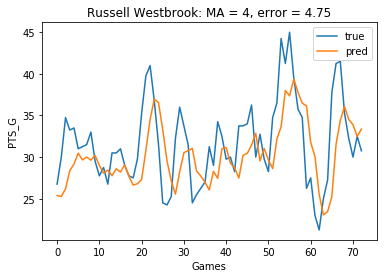

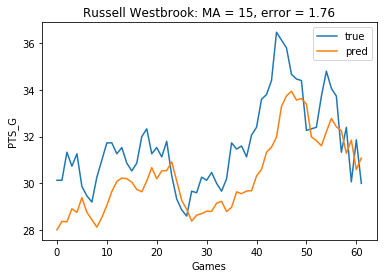

{'ewm': 0.1, 'n': 2, 'rank': 2, 'windowSize': 5}


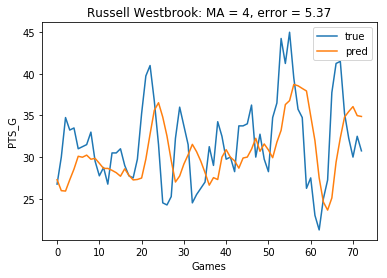

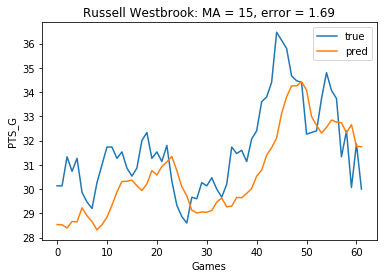

{'ewm': 0.1, 'n': 2, 'rank': 3, 'windowSize': 5}


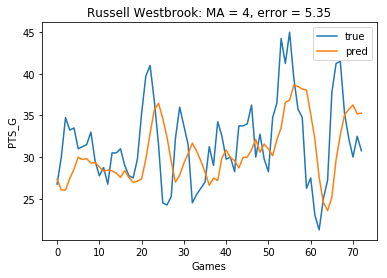

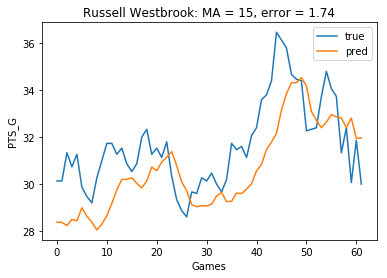

{'ewm': 0.325, 'n': 2, 'rank': 1, 'windowSize': 5}


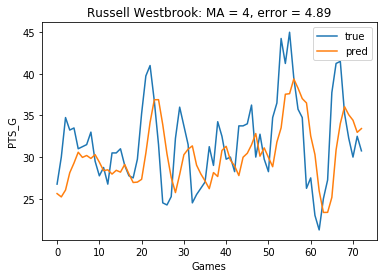

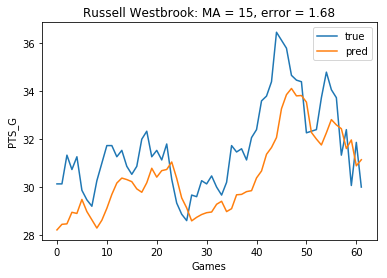

{'ewm': 0.325, 'n': 2, 'rank': 2, 'windowSize': 5}


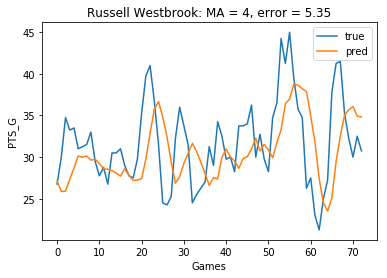

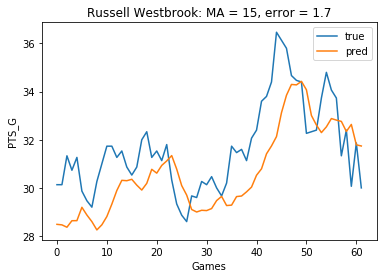

{'ewm': 0.325, 'n': 2, 'rank': 3, 'windowSize': 5}


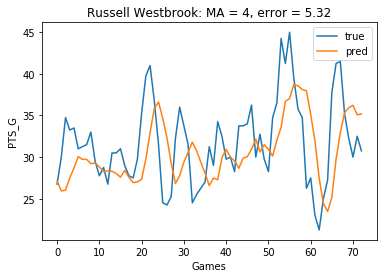

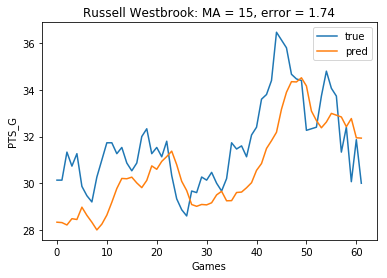

{'ewm': 0.55, 'n': 2, 'rank': 1, 'windowSize': 5}


KeyboardInterrupt: 

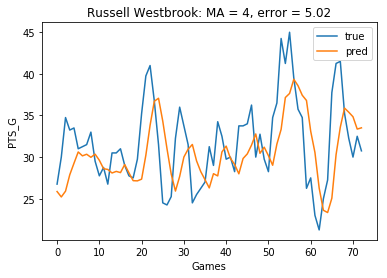

In [7]:
""" Set SLA Method """
if slaType.lower() == 'ridge':
    slaGrid = ridgeGrid
elif slaType.lower() == 'svr':
    slaGrid = svrGrid
elif slaType.lower() == 'randomforest':
    slaGrid = randomForestGrid
else:
    slaGrid = lrGrid

""" Begin Experiment """
for player in players:     
    # initialize optimality conditions
    optSLA_params = slaGrid[0]
    error = float("inf")
    
    """ TRAIN + CV Stage """
    for paramDict in slaGrid:
        print("{}".format(paramDict))

        # train and forecast on CV data
        predsSLA, true = gamePredictions.SLATrainTest(slaType, paramDict, dfTrain, dfCV, player, 
                                                      catFeatureTypes, metric)
        
        # compute error
        errorTemp = rmseMA(predsSLA, true, weekWindow)
        if errorTemp <= error: 
            error = errorTemp
            optSLA_params = paramDict
        
        # plot
        plotData.plotMA(predsSLA, true, weekWindow, player, metric)
        plotData.plotMA(predsSLA, true, monthWindow, player, metric)
        
    # update player params
    playerSLA_paramsDict[player] = optSLA_params
    
    print("{}: optimal SLA {} params = {}".format(player, slaMethod, optSLA_params))
    print("Error = {}".format(error.round(2)))
    print()

In [12]:
playerSLA_paramsDict = {player: {'ewm': 0.1, 'rank': 1, 'n': 2, 'windowSize': 5} for player in players}
# split data into train/cv/test
dfTrain, dfCV, dfTest = gameData.splitDFs(df_games, trainDates, cvDates, testDates)
dfTrainCV = pd.concat([dfTrain, dfCV])

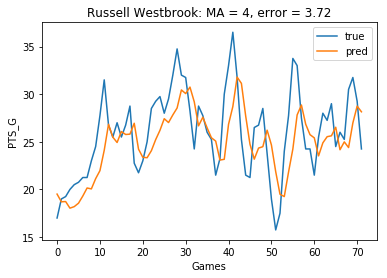

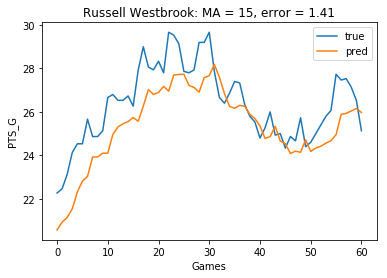

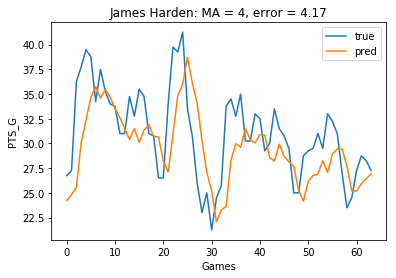

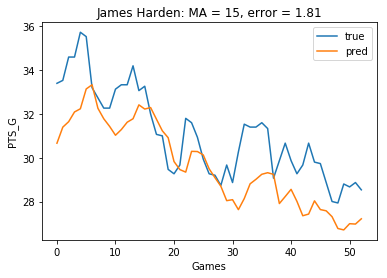

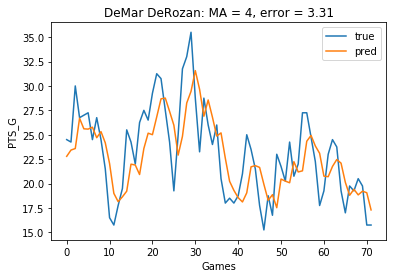

...

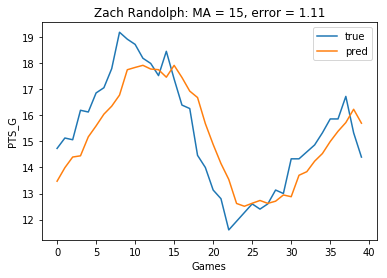

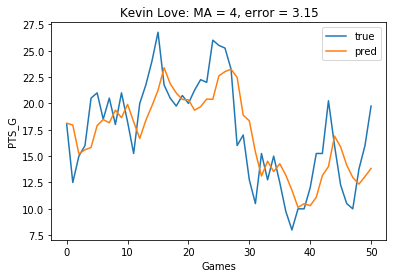

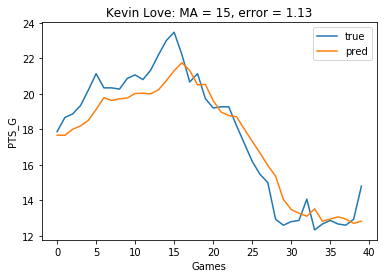

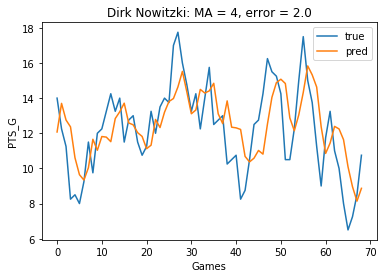

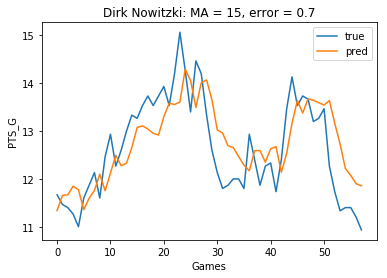

KeyboardInterrupt: 

In [13]:
""" TESTING STAGE """
slaErrorsDictWeek = {player: 0 for player in players}
slaErrorsDictMonth = {player: 0 for player in players}

for player in players: 
    # get optimal hyper-parameters
    optSLA_params = playerSLA_paramsDict[player]
    
    # retrain on (train, cv) data and forecast on test
    predsSLA, true = gamePredictions.SLATrainTest(slaType, optSLA_params, dfTrainCV, dfTest, player, 
                                                  catFeatureTypes, metric)  
    
    # compute error (minimize w.r.t. weekly error)
    error = rmseMA(predsSLA, true, weekWindow)
    slaErrorsDictWeek[player] = round(error, roundNum)
    error = rmseMA(predsSLA, true, monthWindow)
    slaErrorsDictMonth[player] = round(error, roundNum)
    
    # plot
    plotData.plotMA(predsSLA, true, weekWindow, player, metric)
    plotData.plotMA(predsSLA, true, monthWindow, player, metric)

## ARIMA Predictions

In [6]:
""" Set ARIMA Hyper-parameters """
#d = np.linspace(3, 10, 3)
d = np.array([3])
p = np.array([1])
q = np.array([0])

""" Create ARIMA Parameter Grids """
arimaDict = {'d': d, 'p': p, 'q': q}
arimaGrid = list(ParameterGrid(arimaDict))

# players
playerARIMA_paramsDict = {player: dict() for player in players}

{'d': 3, 'p': 1, 'q': 0}


/anaconda3/lib/python3.7/site-packages/scipy/signal/signaltools.py:1341: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out_full[ind] += zi
/anaconda3/lib/python3.7/site-packages/scipy/signal/signaltools.py:1344: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out = out_full[ind]
/anaconda3/lib/python3.7/site-packages/scipy/signal/signaltools.py:1350: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `ar

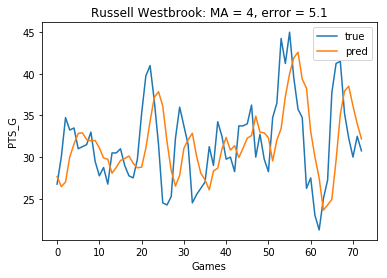

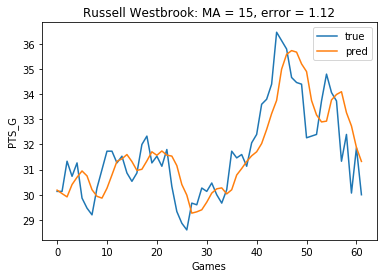

Russell Westbrook: optimal ARIMA params = {'d': 3, 'p': 1, 'q': 0}
Error = 5.1

{'d': 3, 'p': 1, 'q': 0}


KeyboardInterrupt: 

In [7]:
""" TRAIN + CV Stages """
for player in players: 
    buffer = playerSLA_paramsDict[player]['windowSize']
    
    # initialize optimality conditions
    optARIMA_params = arimaGrid[0]
    error = float("inf")
    
    for paramDict in arimaGrid:
        print("{}".format(paramDict))
        
        # train and forecast on cv
        predsARIMA, true = gamePredictions.ARIMATrainTest(paramDict, dfTrain, dfCV, player, buffer, metric)
        
        # compute error
        errorTemp = rmseMA(predsARIMA, true, weekWindow)
        if errorTemp <= error: 
            error = errorTemp
            optARIMA_params = paramDict
        
        # plot
        plotData.plotMA(predsARIMA, true, weekWindow, player, metric)
        plotData.plotMA(predsARIMA, true, monthWindow, player, metric)
    
    # update player params
    playerARIMA_paramsDict[player] = optARIMA_params
    
    print("{}: optimal ARIMA params = {}".format(player, optARIMA_params))
    print("Error = {}".format(error.round(2)))
    print()
    

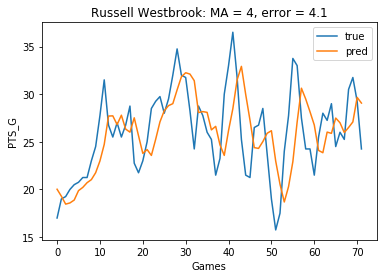

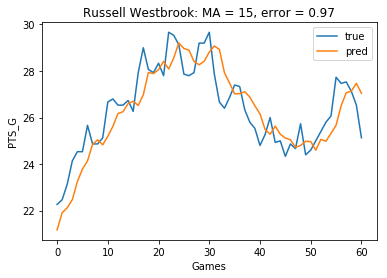

KeyError: 'd'

In [8]:
""" TEST """
arimaErrorsDictWeek = {player: 0 for player in players}
arimaErrorsDictMonth = {player: 0 for player in players}

for player in players:
    # get optimal hyperparameters
    optARIMA_params = playerARIMA_paramsDict[player]
    buffer = playerSLA_paramsDict[player]['windowSize']
    
    # train on (train, cv) data and forecast on test
    predsARIMA, true = gamePredictions.ARIMATrainTest(optARIMA_params, dfTrainCV, dfTest, player, buffer, metric)
    
    # compute error (minimize w.r.t. weekly error)
    error = rmseMA(predsARIMA, true, weekWindow)
    arimaErrorsDictWeek[player] = round(error, roundNum)
    error = rmseMA(predsARIMA, true, monthWindow)
    arimaErrorsDictMonth[player] = round(error, roundNum)

    # plot
    plotData.plotMA(predsARIMA, true, weekWindow, player, metric)
    plotData.plotMA(predsARIMA, true, monthWindow, player, metric)

In [19]:
arimaErrorsDictWeek

{'Russell Westbrook': 4.096,
 'James Harden': 0,
 'DeMar DeRozan': 0,
 'Stephen Curry': 0,
 'LeBron James': 0,
 'Kemba Walker': 0,
 'Kyrie Irving': 0,
 'Jimmy Butler': 0,
 'John Wall': 0,
 'Dwyane Wade': 0,
 'Paul George': 0,
 'Klay Thompson': 0,
 'Carmelo Anthony': 0,
 'Kevin Durant': 0,
 'Chris Paul': 0,
 'Al Horford': 0,
 'LaMarcus Aldridge': 0,
 'Manu Ginobili': 0,
 'Tony Parker': 0,
 'Dwight Howard': 0,
 'Trevor Ariza': 0,
 'Zach Randolph': 0,
 'Kevin Love': 0,
 'Dirk Nowitzki': 0,
 'DeAndre Jordan': 0,
 'Blake Griffin': 0,
 'Corey Brewer': 0,
 'Greg Monroe': 0,
 'J.J. Redick': 0,
 'Jamal Crawford': 0}

In [17]:
arimaErrorsDictMonth

{'Russell Westbrook': 0.9704245146687724,
 'James Harden': 1.239806925228187,
 'DeMar DeRozan': 1.2575258473202515,
 'Stephen Curry': 1.4410230470730567,
 'LeBron James': 0.8603769870372823,
 'Kemba Walker': 1.1062105514379326,
 'Kyrie Irving': 1.0425235372227752,
 'Jimmy Butler': 1.1198709697168783,
 'John Wall': 0.8463186117660407,
 'Dwyane Wade': 0.8158579138469484,
 'Paul George': 1.2428037457492076,
 'Klay Thompson': 0.6492688755167731,
 'Carmelo Anthony': 0.9145273405530301,
 'Kevin Durant': 1.0893129390551421,
 'Chris Paul': 1.0028718750322525,
 'Al Horford': 0.664741310159762,
 'LaMarcus Aldridge': 1.0223319176807415,
 'Manu Ginobili': 0.7898909110932681,
 'Tony Parker': 0.8329545022255616,
 'Dwight Howard': 0.9313799458765353,
 'Trevor Ariza': 0.5406365705313807,
 'Zach Randolph': 1.2183717244885182,
 'Kevin Love': 1.2799251391233775,
 'Dirk Nowitzki': 0.6562822286554068,
 'DeAndre Jordan': 0.7345637786197894,
 'Blake Griffin': 0.8329541422114944,
 'Corey Brewer': 0.6927619685

# ANNUAL PREDICTIONS

In [ ]:
predMetrics = ["PTS_G"]

players = ['Russell Westbrook', 'James Harden',
       'DeMar DeRozan', 'Stephen Curry', 'LeBron James',
       'Kawhi Leonard',
        'Kemba Walker',
       'Kyrie Irving', 'Jimmy Butler', 'John Wall', 'Dwyane Wade',
       'Paul George', 'Klay Thompson', 'Carmelo Anthony',
       'Gordon Hayward', 'Kevin Durant', 'Brook Lopez',
       'Goran Dragic', 'Marc Gasol', 'Lou Williams', 'Chris Paul',
          'Al Horford', 'Al Jefferson','LaMarcus Aldridge', 'Manu Ginobili', 'Tony Parker',
          'Dwight Howard', 'Trevor Ariza', 'Zach Randolph', 'Vince Carter', 'Rudy Gay', 'Kevin Love',
          'Dirk Nowitzki', 'DeAndre Jordan', 'Blake Griffin', 'Andre Iguodala', 'Arron Afflalo',
          'Avery Bradley', 'Beno Udrih', 'C.J. Miles', 'Corey Brewer', 'David Lee', 'David West',
          'Deron Williams', 'Derrick Rose', 'Greg Monroe', 'J.J. Barea',
 'J.J. Redick', 'J.R. Smith', 'Jamal Crawford', 'Jameer Nelson', 'Jason Terry', 'Jeff Green', 'Jared Dudley', 'Joe Johnson', 
          'Jose Calderon', 'Kenneth Faried', 'Kyle Korver', 'Kyle Lowry', 'Leandro Barbosa', 'Marcin Gortat',
 'Marco Belinelli', 
 'Marcus Thornton',
 'Marreese Speights',
 'Marvin Williams',
 'Matt Barnes', 'Mike Conley', 'Michael Beasley','Monta Ellis',
 'Nene Hilario',
 'Nick Young',
 'Nicolas Batum','Omer Asik',
 'Omri Casspi',
           'Pau Gasol',
           'Paul Millsap',
 'Rajon Rondo',
 'Ramon Sessions',
 'Randy Foye',
 'Raymond Felton',
 'Reggie Jackson',
 'Richard Jefferson',
 'Robin Lopez',
 'Rodney Stuckey',
 'Roy Hibbert',
          'Serge Ibaka',
 'Shaun Livingston',
 'Spencer Hawes','Taj Gibson', 'Tony Allen', 'Wayne Ellington',
 'Wesley Johnson',
 'Wesley Matthews', 'Zaza Pachulia']

## Adding 2018 data

In [4]:
d1 = '2017-09-01'
d2 = '2018-06-01'
df = pd.read_csv("../data/nba-enhanced-stats/2012-18_playerBoxScore.csv")
df_recent = df[(df.gmDate >= d1) & (df.gmDate <= d2)]

colname_dict = {'playPTS': 'PTS', 'playAST': 'AST', 'playTO':'TOV',
                'playFG%': 'FG%','playFT%':'FT%','play3PM':'3P',
                'playTRB':'TRB','playSTL':'STL','playBLK':'BLK',
                'teamAbbr': 'Tm', 'playPos': 'Pos', 'playMin': 'MP',
                'playDispNm': 'Player'}
df_recent = df_recent.rename(columns=colname_dict)

# add games played
numGmsPlayed = df_recent.groupby(['Player']).count()['gmDate'].values

# take totals 
sumColumns = ['PTS', 'AST', 'TOV', '3P', 'TRB', 'STL', 'BLK', 'MP']
avgColumns = ['FG%', 'FT%']
d = {sumColumn: 'sum' for sumColumn in sumColumns}
dtemp = {avgColumn: 'mean' for avgColumn in avgColumns}
d.update(dtemp)
df_recent = df_recent.groupby(['Player'], as_index=False).agg(d)
df_recent['Year'] = 2018

# fix accented characters
df_recent.Player = df_recent.Player.str.normalize('NFKD').str.encode('ascii', errors='ignore').str.decode('utf-8')

# add games played
df_recent['G'] = numGmsPlayed

## RSC Predictions

In [12]:
""" USER PARAMETERS """
starting_year = 1970
min_games = 30
min_years = 2
validate_year = 2017
pred_interval = 1
params = [starting_year, min_games, min_years, validate_year, pred_interval]

In [13]:
"""
setup
"""
# user input
donor_window_type = 'sliding'
normalize_metric = None 
threshold = 0.98
helper_metrics = []

# setup 
donorSetup= [normalize_metric, donor_window_type, True]
denoiseSetup = ["SVD", "all"]
regression_method = "pinv"
verbose = False
metrics = [[metric] + helper_metrics for metric in predMetrics]

In [16]:
# create annual data
stats = annualData.createAnnualData(params, df_recent)

# create donor / target for validation
donor_v, allPivotedTableDict_v, _, _ = annualData.createTargetDonors(params, stats)

# create donor / target for testing (update prediction year)
params[3] = params[3] + 1
donor, allPivotedTableDict, targetPlayers, stats = annualData.createTargetDonors(params, stats)

/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:4097: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:480: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


In [17]:
validPlayers = list(set(players) & set(targetPlayers))
validPlayers.sort()

In [18]:
# create evaluation dataframes
all_pred = pd.DataFrame()
all_true = pd.DataFrame()
all_val = pd.DataFrame()

method = 'Convex'
alpha = 0.1
arima_params = (1,1,0)
ewm_param = 0.3

# use 'targetPlayers' from 'pred_year'
for targetPlayer in validPlayers: 
    player_pred = pd.DataFrame()
    player_true = pd.DataFrame()
    player_val = pd.DataFrame()
    
    for metric in metrics: 
        """ VALIDATION STAGE """
        # get predictions
        preds_val, y_val = annualPredictions.getPredictions(targetPlayer, allPivotedTableDict_v, donor_v, 
                                                            pred_interval, metric, predMetrics, threshold, 
                                                            donorSetup, denoiseSetup, regression_method, 
                                                            verbose, arima_params, ewm_param)
        
        # learn weights
        weights = predictionMethods.learnWeights(preds_val, y_val, method, alpha)
        
        """ PREDICTION STAGE """
        # get predictions
        preds_test, y_test = annualPredictions.getPredictions(targetPlayer, allPivotedTableDict, donor, 
                                                              pred_interval, metric, predMetrics, threshold, 
                                                              donorSetup, denoiseSetup, regression_method, 
                                                              verbose, arima_params, ewm_param)
        
        # make final predictions
        pred_final = predictionMethods.combinePredictions(preds_test, weights) 
        
        """ PRESENTATION STAGE """   
        df_pred = pd.DataFrame(pred_final)
        df_pred.columns = [targetPlayer]
        df_pred.index = [metric]
        player_pred = pd.concat([player_pred, df_pred], axis=0)
        
        df_true = pd.DataFrame(y_test)
        df_true.columns = [targetPlayer]
        df_true.index = [metric]
        player_true = pd.concat([player_true, df_true], axis=0)
        
    all_pred = pd.concat([all_pred, player_pred], axis=1)
    all_true = pd.concat([all_true, player_true], axis=1)
    
print("DONE!")

../../mrsc/src/predictions/annualPredictions.py:76: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.dropna(axis='columns', inplace=True)
/anaconda3/lib/python3.7/site-packages/statsmodels/tsa/kalmanf/kalmanfilter.py:649: RuntimeWarning: divide by zero encountered in true_divide
  R_mat, T_mat)


DONE!


In [19]:
error = all_true - all_pred
all_true.index = ['True']
all_pred.index = ['Pred']
error.index = ['Error']
df_annual = pd.concat([all_true, all_pred, error]).T
#df_annual.sort_values(by=['Error']).head()

In [21]:
df_annual.head()

,True,Pred,Error
Al Horford,12.875000,12.702669,0.172331
Al Jefferson,7.000000,7.161425,-0.161425
Andre Iguodala,6.000000,7.696791,-1.696791
Arron Afflalo,3.442308,8.693835,-5.251527
Avery Bradley,14.260870,15.109966,-0.849096


# Combining Predictions

In [ ]:
preds = np.vstack([predsSLA, predsARIMA]).T
numPredictors = preds.shape[1]

predsCombined = forecastCombined(true, preds, numPredictors, learningRate=0.2)
error = rmseMA(predsCombined, true, weekWindow)
print("Error = {}".format(error.round(3)))
plotData.plotMA(predsCombined, true, weekWindow, player, metric)
plotData.plotMA(predsCombined, true, monthWindow, player, metric)

## WORKING OLD CODE

In [ ]:
""" Set SLA Method """
slaMethod = 'linear'
catFeatureTypes = ['teamLoc', 'gameOutcome']

if slaMethod.lower() == 'ridge':
    slaGrid = ridgeGrid
elif slaMethod.lower() == 'svr':
    slaGrid = svrGrid
elif slaMethod.lower() == 'randomforest':
    slaGrid = randomForestGrid
else:
    slaGrid = lrGrid

""" Begin Experiment """
for player in players: 
    # split into train/cv/test
    dfTrain, dfCV, dfTest = gameData.splitDFs(df_games, player, trainDates, cvDates, testDates)
    datesTrain = dfTrain.gmDate.values
    datesCV = dfCV.gmDate.values
    datesTest = dfTest.gmDate.values
    
    # used for checking if top teammates are playing
    dfAllTrain = df_games[df_games.gmDate >= datesTrain[0]]
    dfAllCV = df_games[df_games.gmDate >= datesCV[0]]
    
    # initialize optimality conditions
    optSLA_params = slaGrid[0]
    error = float("inf")
    
    """ TRAIN + CV Stage """
    for paramDict in slaGrid:
        print("{}".format(paramDict))
        
        # hyper-parameters
        windowSize = paramDict['windowSize']
        rank = paramDict['rank']
        ewmParam = paramDict['ewm']
        n = paramDict['n']
        
        """ Train Stage """
        # construct (featureMatrix, labels)
        featureMatrix, labels = SLA.constructFeatureMatrixLabels(dfTrain, dfAllTrain, player,
                                                                 windowSize, datesTrain, catFeatureTypes,
                                                                 metric, ewmParam, n)
        
        # de-noise featureMatrix
        featureMatrix[:, :3] = hsvt(featureMatrix[:, :3], rank=rank)
        
        # create SLA forecaster and fit
        sla = SLA.SLAForecast(slaMethod, paramDict)
        sla.fit(featureMatrix, labels)
        
        """ CV Stage """
        # SLA forecast
        predsSLA, true = gamePredictions.forecastSLA(dfCV, dfAllCV, player, windowSize, datesCV,
                                                     catFeatureTypes, sla, featureMatrix[:, :3], 
                                                     metric, ewmParam, n)
        
        # compute error
        errorTemp = rmseMA(predsSLA, true, weekWindow)
        if errorTemp <= error: 
            error = errorTemp
            optSLA_params = paramDict
        
        # plot
        plotData.plotMA(predsSLA, true, weekWindow, player, metric)
        plotData.plotMA(predsSLA, true, monthWindow, player, metric)
        
    # update player params
    playerSLA_paramsDict[player] = optSLA_params
    
    print("{}: optimal SLA {} params = {}".format(player, slaMethod, optSLA_params))
    print("Error = {}".format(error.round(2)))
    print()
    
""" TESTING STAGE """
playersErrorDictWeek = {player: 0 for player in players}
playersErrorDictMonth = {player: 0 for player in players}

for player in players: 
    # get optimal hyper-parameters
    optSLA_params = playerSLA_paramsDict[player]
    windowSize = optSLA_params['windowSize']
    rank = optSLA_params['rank']
    ewmParam = optSLA_params['ewm']
    n = optSLA_params['n']
    
    # split into (train, cv)/test
    dfTrain, dfCV, dfTest = gameData.splitDFs(df_games, player, trainDates, cvDates, testDates)
    dfTrainCV = pd.concat([dfTrain, dfCV])
    datesTrainCV = dfTrainCV.gmDate.values
    datesTest = dfTest.gmDate.values
    
    # used for checking if top teammates are playing
    dfAllTrainCV = df_games[df_games.gmDate >= datesTrainCV[0]]
    dfAllTest = df_games[df_games.gmDate >= datesTest[0]]
    
    # retrain with Training + CV data
    featureMatrix, labels = SLA.constructFeatureMatrixLabels(dfTrainCV, dfAllTrainCV, player,
                                                                 windowSize, datesTrainCV, catFeatureTypes,
                                                                 metric, ewmParam, n)
    featureMatrix[:, :3] = hsvt(featureMatrix[:, :3], rank=rank)
    sla = SLA.SLAForecast(slaMethod, optSLA_params)
    sla.fit(featureMatrix, labels)
    
    # SLA forecast
    predsSLA, true = gamePredictions.forecastSLA(dfTest, dfAllTest, player, windowSize, datesTest,
                                                 catFeatureTypes, sla, featureMatrix[:, :3],
                                                 metric, ewmParam, n)    
    
    # compute error (minimize w.r.t. weekly error)
    error = rmseMA(predsSLA, true, weekWindow)
    playersErrorDictWeek[player] = error
    error = rmseMA(predsSLA, true, monthWindow)
    playersErrorDictMonth[player] = error

    # plot
    plotData.plotMA(predsSLA, true, weekWindow, player, metric)
    plotData.plotMA(predsSLA, true, monthWindow, player, metric)

In [ ]:
""" TRAIN + CV Stages """
for player in players: 
    buffer = playerSLA_paramsDict[player]['windowSize']
    
    dfTrain, dfCV, dfTest = gameData.splitDFs(df_games, player, trainDates, cvDates, testDates)
    datesTrain = dfTrain.gmDate.values
    datesCV = dfCV.gmDate.values
    datesTest = dfTest.gmDate.values
    
    # initialize optimality conditions
    optARIMA_params = arimaGrid[0]
    error = float("inf")
    
    for paramDict in arimaGrid:
        predsARIMA, true = gamePredictions.ARIMATrainTest(paramDict, dfTrain, dfCV, datesCV, buffer, metric)
        
        """ CV Stage """
        d = int(paramDict['d'])
        p = int(paramDict['p'])
        q = int(paramDict['q'])
        arimaParams = (d, p, q)
        
        # ARIMA forecast
        trainHistory = dfTrain[metric].values
        cvHistory = dfCV.loc[dfCV.gmDate.isin(datesCV[:buffer]), metric].values
        history = np.append(trainHistory, cvHistory)
        predsARIMA, true = gamePredictions.forecastARIMA(dfCV, datesCV, buffer, metric, history, arimaParams)
        
        # compute error
        errorTemp = rmseMA(predsARIMA, true, weekWindow)
        print("{} error: {}".format(paramDict, errorTemp.round(3)))
        print()
        if errorTemp <= error: 
            error = errorTemp
            optARIMA_params = paramDict
        
        # plot
        plotData.plotMA(predsARIMA, true, weekWindow, player, metric)
        plotData.plotMA(predsARIMA, true, monthWindow, player, metric)
    
    # update player params
    playerARIMA_paramsDict[player] = optARIMA_params
    
    print("{}: optimal ARIMA params = {}".format(player, optARIMA_params))
    print("Error = {}".format(error.round(2)))
    print()
    
""" TEST """
for player in players: 
    buffer = playerSLA_paramsDict[player]['windowSize']
    
    # combine Training and CV data 
    dfTrain, dfCV, dfTest = gameData.splitDFs(df_games, player, trainDates, cvDates, testDates)
    dfTrainCV = pd.concat([dfTrain, dfCV])
    datesTrainCV = dfTrainCV.gmDate.values
    
    # testing data
    datesTest = dfTest.gmDate.values
    
    # get optimal hyperparameters
    optARIMA_params = playerARIMA_paramsDict[player]
    
    # train on (train, cv) data and forecast on test
    predsARIMA, true = gamePredictions.ARIMATrainTest(optARIMA_params, dfTrainCV, dfCV, datesCV, buffer, metric)
    
    # get optimal hyperparameters
    optARIMA_params = playerARIMA_paramsDict[player]
    d = int(optARIMA_params['d'])
    p = int(optARIMA_params['p'])
    q = int(optARIMA_params['q'])
    arimaParams = (d, p, q)
        
    # ARIMA forecast
    trainCVHistory = dfTrainCV[metric].values
    testHistory = dfTest.loc[dfTest.gmDate.isin(datesTest[:buffer]), metric].values
    history = np.append(trainCVHistory, testHistory)
    predsARIMA, true = gamePredictions.forecastARIMA(dfTest, datesTest, buffer, metric, history, arimaParams)
        
    # compute error
    error = rmseMA(predsARIMA, true, weekWindow)
    print("{} error: {}".format(optARIMA_params, error.round(3)))
        
    # plot
    plotData.plotMA(predsARIMA, true, weekWindow, player, metric)
    plotData.plotMA(predsARIMA, true, monthWindow, player, metric)

# Teammate Effect

In [60]:
""" create dictionary of top n players per team """
n = 2

df = df_games[(df_games.gmDate >= cvDates[0]) & (df_games.gmDate <= cvDates[1])]

teams = df.teamAbbr.unique()
teamsDict = {team: [] for team in teams}
for team in teams: 
    dfTeam = df[df.teamAbbr == team]
    dfAvg = dfTeam.groupby('Player', as_index=False)['PTS_G'].mean()
    teamsDict[team] = dfAvg.nlargest(n, columns=['PTS_G'])['Player'].values

In [ ]:
""" CORRELATION BETWEEN PERFORMANCES OF TOP TWO PLAYERS PER TEAM """
n = 2
teams = df.teamAbbr.unique()
teamsDict = {team: [] for team in teams}
for team in teams:
    # get team dataframe
    dfTeam = df[df.teamAbbr == team]
    
    # get top n players per team
    dfAvg = dfTeam.groupby('Player', as_index=False)['PTS_G'].mean()
    topPlayers = dfAvg.nlargest(n, columns=['PTS_G'])['Player'].values
    teamsDict[team] = topPlayers
    
    # get dates in which all players played
    dfTeamTop = dfTeam.loc[dfTeam.Player.isin(topPlayers), ['gmDate', 'Player', 'PTS_G']]
    dates = dfTeamTop.gmDate.unique()
    validDates = list()
    for date in dates:
        if dfTeamTop[dfTeamTop.gmDate == date].count()['gmDate'] == n: 
            validDates.append(date)
    dfTeamTop = dfTeamTop[dfTeamTop.gmDate.isin(validDates)]
    
    plt.figure()
    for player in topPlayers:
        vals = dfTeamTop.loc[dfTeamTop.Player==player, 'PTS_G'].values
        plt.plot(vals, label=player)
    plt.legend(loc='best')
    plt.title(team)
    plt.show()
    
    series1 = pd.Series(dfTeamTop.loc[dfTeamTop.Player==topPlayers[0], 'PTS_G'].values)
    print("Correlation = {}".format(series1.corr(pd.Series(vals))))

In [ ]:
""" TEAM PTS/G WITH AND WITHOUT TOP PLAYERS """

cols = ['gmDate', 'Player', 'playStat', 'teamAbbr', 'teamLoc', 'teamRslt', 'opptAbbr', 'PTS_G']
df = df_games.loc[(df_games.gmDate >= testDates[0]) & (df_games.gmDate <= testDates[1]), cols]

team = 'HOU'
players = teamsDict[team]
p1 = players[0]
p2 = players[1]

dfTeam = df[df.teamAbbr == team]
dfTop = dfTeam[dfTeam.Player.isin([p1, p2])]

dates = dfTop.gmDate.unique()
overlapDates = list()
nonOverlapDates = list()
for date in dates:
    if dfTop[dfTop.gmDate == date].count()['gmDate'] == 2: 
        overlapDates.append(date)
    else:
        nonOverlapDates.append(date)
        
""" Get Team PTS_G up to (but no including) date """
def getTeamPTS_G(dfTeam, date): 
    df = dfTeam.loc[dfTeam.gmDate < date]
    return df['PTS_G'].sum() / len(df.gmDate.unique())

""" Get Team PTS on date """
def getTeamPTS(dfTeam, date): 
    df = dfTeam.loc[dfTeam.gmDate == date]
    return df['PTS_G'].sum() 

for date in nonOverlapDates: 
    pts = getTeamPTS(dfTeam, date)
    pts_g = getTeamPTS_G(dfTeam, date)

    print("Date: {}".format(date))
    print("Scored {} points".format(pts, date))
    print("AVG {} points".format(pts_g, date))
    print()

In [67]:
""" PTS/G WITH AND WITHOUT TEAMMATE """

for team, players in teamsDict.items(): 
    p1 = players[0]
    p2 = players[1]

    dfTeam = df[df.teamAbbr == team]
    dfTop = dfTeam[dfTeam.Player.isin([p1, p2])]

    dates = dfTop.gmDate.unique()
    overlapDates = list()
    nonOverlapDates = list()
    for date in dates:
        if dfTop[dfTop.gmDate == date].count()['gmDate'] == 2: 
            overlapDates.append(date)
        else:
            nonOverlapDates.append(date)

    p1Avg = dfTop.loc[(dfTop.Player==p1) & (dfTop.gmDate.isin(overlapDates)), 'PTS_G'].mean()
    df1 = dfTop.loc[(dfTop.Player==p1) & (dfTop.gmDate.isin(nonOverlapDates)), ['gmDate', 'Player', 'PTS_G']]
    df1['Overlap AVG'] = p1Avg

    p2Avg = dfTop.loc[(dfTop.Player==p2) & (dfTop.gmDate.isin(overlapDates)), 'PTS_G'].mean()
    df2 = dfTop.loc[(dfTop.Player==p2) & (dfTop.gmDate.isin(nonOverlapDates)), ['gmDate', 'Player', 'PTS_G']]
    df2['Overlap AVG'] = p2Avg
    
    print("*** {} ***".format(team))
    #print(df1)
    diff1 = df1['PTS_G'].mean() - p1Avg
    print("{} Diff = {}".format(p1, round(diff1, 2)))
    #print(df2)
    
    diff2 = df2['PTS_G'].mean() - p2Avg
    print("{} Diff = {}".format(p2, round(diff2, 2)))
    print()

*** NY ***
Carmelo Anthony Diff = -0.6
Kristaps Porzingis Diff = -3.8

*** CLE ***
LeBron James Diff = 2.57
Kyrie Irving Diff = 0.12

*** UTA ***
Gordon Hayward Diff = 1.35
George Hill Diff = 3.23

*** POR ***
Damian Lillard Diff = nan
C.J. McCollum Diff = 8.79

*** SA ***
Kawhi Leonard Diff = 0.54
LaMarcus Aldridge Diff = -0.28

*** GS ***
Stephen Curry Diff = 2.16
Kevin Durant Diff = -0.6

*** DAL ***
Harrison Barnes Diff = 2.77
Dirk Nowitzki Diff = 1.83

*** IND ***
Paul George Diff = nan
Jeff Teague Diff = 2.49

*** MIA ***
Goran Dragic Diff = 0.99
Hassan Whiteside Diff = -1.56

*** ORL ***
Evan Fournier Diff = 0.45
Serge Ibaka Diff = -0.88

*** BKN ***
Brook Lopez Diff = 0.66
Jeremy Lin Diff = -0.58

*** BOS ***
Isaiah Thomas Diff = 6.31
Avery Bradley Diff = 3.08

*** DET ***
Tobias Harris Diff = 0.62
Reggie Jackson Diff = nan

*** TOR ***
DeMar DeRozan Diff = 0.35
Kyle Lowry Diff = 3.29

*** MIN ***
Karl-Anthony Towns Diff = nan
Andrew Wiggins Diff = nan

*** MEM ***
Mike Conley 

# IGNORE

In [ ]:
""" WEEKLY/MONTHLY UPDATES SLA """
""" project feature onto de-noised feature space """
def projectFeature(featureMatrix, feature): 
    regr = linear_model.LinearRegression(fit_intercept=False)
    regr.fit(featureMatrix.T, feature)
    return np.dot(featureMatrix.T, regr.coef_)

""" Forecast via Supervised Learning Method """
def forecastSLA(df, dates, window, metric, sla, featureMatrix, labels, ewmParam=0.5): 
    predsSLA = np.array([])
    true = np.array([])
    
    count = 1
    featureWeek = np.array([])
    labelWeek = np.array([])
    for i in range(window, len(dates)):
        # get current game information
        currDate = dates[i]
        currGamePerf = df.loc[df.gmDate == currDate, metric].mean()
        true = np.append(true, currGamePerf)
        teamLoc = df.loc[df.gmDate == currDate, 'teamLoc']
        if (teamLoc == 'Home').bool(): 
            teamLoc = 1
        else:
            teamLoc = -1

        # get previous game information
        prevDate = dates[i-1]
        prevGameOutcome = df.loc[df.gmDate == prevDate, 'teamRslt']
        if (prevGameOutcome == 'Win').bool():
            prevGameOutcome = 1
        else:
            prevGameOutcome = -1

        # create feature
        gameInfo = np.array([prevGameOutcome, teamLoc])
        datesWindow = dates[i-window: i]
        windowVals = df.loc[df.gmDate.isin(datesWindow), metric].values
        feature = SLA.getWindowFeature(windowVals, ewmParam)
        windowFeatureLen = len(feature)

        # project feature onto de-noised space
        featureProj = projectFeature(featureMatrix[:, :windowFeatureLen], feature)

        # forecast
        featureProj = np.append(featureProj, gameInfo)
        predSLA = sla.model.predict(featureProj.reshape(1, featureProj.shape[0]))[0]
        predsSLA = np.append(predsSLA, predSLA)  
        
        
        """feature = np.append(feature, gameInfo)
        featureMatrix = np.vstack([featureMatrix, feature])
        # featureMatrix = np.vstack([featureMatrix, featureProj])
        labels = np.append(labels, currGamePerf)
        sla.fit(featureMatrix, labels)"""
        
        # update model every 4 games (~1 week)
        if count == 15: 
            featureMatrix = np.vstack([featureMatrix, featureWeek])
            labels = np.append(labels, labelWeek)
            sla.fit(featureMatrix, labels)
            count = 1
        else: 
            feature = np.append(feature, gameInfo)
            featureWeek = np.vstack([featureWeek, feature]) if featureWeek.size else feature
            labelWeek = np.append(labelWeek, currGamePerf)
            count += 1
        
        #count += 1
    
    return predsSLA, true


""" Set SLA Method """
slaMethod = 'linear'

if slaMethod.lower() == 'ridge':
    slaGrid = ridgeGrid
elif slaMethod.lower() == 'svr':
    slaGrid = svrGrid
elif slaMethod.lower() == 'randomforest':
    slaGrid = randomForestGrid
else:
    slaGrid = lrGrid

for player in players: 
    dfTrain, dfCV, dfTest = gameData.splitDFs(df_games, player, trainDates, cvDates, testDates)
    datesTrain = dfTrain.gmDate.values
    datesCV = dfCV.gmDate.values
    datesTest = dfTest.gmDate.values
    
    # initialize optimality conditions
    optSLA_params = slaGrid[0]
    error = float("inf")
    
    """ TRAIN + CV Stage """
    for paramDict in slaGrid: 
        # hyper-parameters
        windowSize = paramDict['windowSize']
        rank = paramDict['rank']
        ewmParam = paramDict['ewm']
        
        """ Train Stage """
        # construct (featureMatrix, labels)
        featureMatrix, labels = SLA.constructFeatureMatrixLabels(dfTrain, windowSize, 
                                                                 datesTrain, metric, ewmParam)
        
        # de-noise featureMatrix
        featureMatrix[:, :3] = hsvt(featureMatrix[:, :3], rank=rank)
        
        # create SLA forecaster and fit
        sla = SLA.SLAForecast(slaMethod, paramDict)
        sla.fit(featureMatrix, labels)
        
        """ CV Stage """
        # SLA forecast (DENNIS)
        predsSLA, true = forecastSLA(dfCV, datesCV, windowSize, metric, 
                                    sla, featureMatrix, labels, ewmParam)
        
        # compute error
        errorTemp = rmseMA(predsSLA, true, weekWindow)
        print("{} error: {}".format(paramDict, errorTemp.round(3)))
        print()
        if errorTemp <= error: 
            error = errorTemp
            optSLA_params = paramDict
        
        # plot
        plotData.plotMA(predsSLA, true, weekWindow, player, metric)
        plotData.plotMA(predsSLA, true, monthWindow, player, metric)
        
    # update player params
    playerSLA_paramsDict[player] = optSLA_params
    
    print("{}: optimal SLA {} params = {}".format(player, slaMethod, optSLA_params))
    print("Error = {}".format(error.round(2)))
    print()
    
""" TESTING STAGE """
playersErrorDict = {player: 0 for player in players}
for player in players: 
    # get optimal hyper-parameters
    optSLA_params = playerSLA_paramsDict[player]
    windowSize = optSLA_params['windowSize']
    rank = optSLA_params['rank']
    ewmParam = optSLA_params['ewm']
    
    # combine Training and CV data 
    dfTrain, dfCV, dfTest = gameData.splitDFs(df_games, player, trainDates, cvDates, testDates)
    dfTrainCV = pd.concat([dfTrain, dfCV])
    datesTrainCV = dfTrainCV.gmDate.values
    
    # testing data
    datesTest = dfTest.gmDate.values
    
    # retrain with Training + CV data
    featureMatrix, labels = SLA.constructFeatureMatrixLabels(dfTrainCV, windowSize, 
                                                             datesTrainCV, metric, ewmParam)
    featureMatrix[:, :3] = hsvt(featureMatrix[:, :3], rank=rank)
    sla = SLA.SLAForecast(slaMethod, optSLA_params)
    sla.fit(featureMatrix, labels)
    
    # SLA forecast (DENNIS)
    predsSLA, true = forecastSLA(dfTest, datesTest, windowSize, metric, 
                                sla, featureMatrix, labels, ewmParam)
        
    # compute error (minimize w.r.t. weekly error)
    error = rmseMA(predsSLA, true, weekWindow)
    playersErrorDict[player] = error
    print("{}: {} error = {}".format(player, optSLA_params, error.round(3)))
    print()

    # plot
    plotData.plotMA(predsSLA, true, weekWindow, player, metric)
    plotData.plotMA(predsSLA, true, monthWindow, player, metric)

In [ ]:
# good

for player in players: 
    dfTrain, dfCV, dfTest = gameData.splitDFs(df_games, player, trainDates, cvDates, testDates)
    datesTrain = dfTrain.gmDate.values
    datesCV = dfCV.gmDate.values
    datesTest = dfTest.gmDate.values

    for window in windowSizes:  
        for method, methodParams in methodDict.items():
            # obtain feature matrix and labels based on training data
            featureMatrix, labels = SLA.constructFeatureMatrixLabels(dfTrain, window, datesTrain, metric)

            for methodParam in methodParams: 
                # training stage
                sla = SLA.SLAForecast(method, methodParam)
                sla.fit(featureMatrix, labels) 

                # CV stage
                pred, true, error = forecastGamePerformance(dfCV, datesCV, window, metric, sla)

                # evaluate 
                print("({}, {}, {}): {}".format(window, method, methodParam, error))
                plotMA(pred, true, weekWindow, player)
                plotMA(pred, true, monthWindow, player)

(4, ridge, 0.1): 10.868323069649945


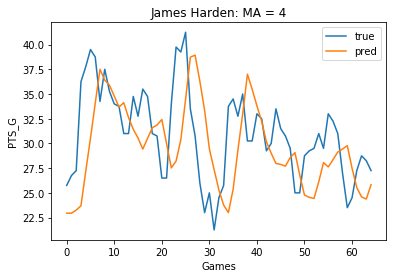

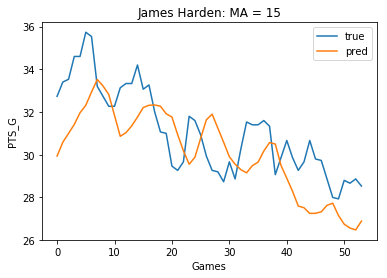

In [7]:
for player in ['James Harden']: 
    window = 4
    method = 'ridge'
    methodParam = 0.1

    # combine Training and CV data
    dfTrain, dfCV, dfTest = gameData.splitDFs(df_games, player, trainDates, cvDates, testDates)
    dfTrainCV = pd.concat([dfTrain, dfCV])
    datesTrainCV = dfTrainCV.gmDate.values
    datesTest = dfTest.gmDate.values

    # retrain with Training + CV data
    featureMatrix, labels = SLA.constructFeatureMatrixLabels(dfTrainCV, window, datesTrainCV, metric)
    sla = SLA.SLAForecast(method, methodParam)
    sla.fit(featureMatrix, labels)

    # test
    pred, true, error = gamePredictions.forecastGamePerformance(dfTest, datesTest, window, metric, sla)

    # evaluate 
    print("({}, {}, {}): {}".format(window, method, methodParam, error))
    plotData.plotMA(pred, true, weekWindow, player, metric)
    plotData.plotMA(pred, true, monthWindow, player, metric)

# Game by Game Data

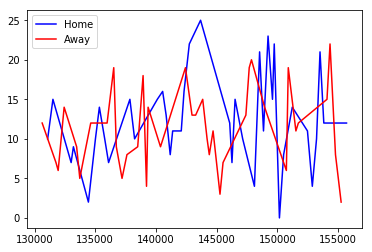

In [34]:
# home games
df_home = df.loc[df.teamLoc=='Home', 'PTS_G']
df_away = df.loc[df.teamLoc=='Away', 'PTS_G']
plt.figure()
plt.plot(df_home, color='blue', label='Home')
plt.plot(df_away, color='red', label='Away')
plt.legend(loc='best')
plt.show()

In [35]:
df_home.mean()

12.256410256410257

In [36]:
df_away.mean()

11.256410256410257

In [42]:
home_mean = list()
away_mean = list()
for player in targetPlayers: 
    home_mean.append(df_games.loc[(df_games.Player==player) & (df_games.teamLoc=='Home'), 'PTS_G'].mean())
    away_mean.append(df_games.loc[(df_games.Player==player) & (df_games.teamLoc=='Away'), 'PTS_G'].mean())
print("Home avg: {}".format(np.nanmean(home_mean)))
print("Away avg: {}".format(np.nanmean(away_mean)))

Home avg: 11.840164990362053
Away avg: 11.607422703506733


In [53]:
teams = df_games['teamAbbr'].unique().tolist()

In [75]:
player = 'Dion Waiters'
d1 = '2012-09-01'
d2 = '2016-06-01'

df_player = df_games[df_games.Player==player]
df_player = df_player[(df_player.gmDate >= d1) & (df_player.gmDate <= d2)]    

In [128]:
def get_factorDict(df, factorName, metric): 
    factorsDict = dict()
    factors = df[factorName].unique()
    for factor in factors: 
        factorsDict[factor] = df.loc[df[factorName] == factor, metric].mean()
    return factorsDict

def printDict(factorDict, factorName):
    print("*** {} ***".format(factorName))
    for key, value in factorDict.items():
        print("{}: {}".format(key, value))
    print("overall: {}".format(np.array(list(factorDict.values())).mean()))
    print()

In [152]:
metric = 'TRB_G'

# Effect of Days Off
factorName = 'teamDayOff'
teamDaysOffDict = get_factorDict(df_games, factorName, metric)
printDict(teamDaysOffDict, factorName)

factorName = 'opptDayOff'
opptDaysOffDict = get_factorDict(df_games, factorName, metric)
printDict(opptDaysOffDict, factorName)

# Effect of Home/Away
factorName = 'teamLoc'
teamLocDict = get_factorDict(df_games, factorName, metric)
printDict(teamLocDict, factorName)

*** teamDayOff ***
0: 4.041994750656168
1: 4.0694253309922646
2: 4.104193091099008
3: 4.08982800982801
4: 4.087916847119965
5: 4.131707317073171
6: 4.040404040404041
7: 4.028735632183908
8: 4.346666666666667
9: 4.133333333333334
11: 4.258064516129032
10: 4.136986301369863
overall: 4.122437986404619

*** opptDayOff ***
0: 4.122226400902595
1: 4.118513788373303
2: 4.068624040158047
3: 4.10055423594616
4: 4.120666959192628
5: 4.062350119904076
6: 4.06496062992126
7: 4.054054054054054
8: 4.169201520912548
9: 4.213143872113677
11: 4.806451612903226
10: 5.0285714285714285
overall: 4.244109888579417

*** teamLoc ***
Away: 4.040082788054867
Home: 4.1418946665982235
overall: 4.090988727326545



In [153]:
# Starters
df_starters = df_games[df_games.playStat=='Starter']

factorName = 'teamDayOff'
teamDaysOffDict = get_factorDict(df_starters, factorName, metric)
printDict(teamDaysOffDict, factorName)

factorName = 'opptDayOff'
opptDaysOffDict = get_factorDict(df_starters, factorName, metric)
printDict(opptDaysOffDict, factorName)

# Bench
factorName = 'teamLoc'
teamLocDict = get_factorDict(df_starters, factorName, metric)
printDict(teamLocDict, factorName)

*** teamDayOff ***
0: 5.530538922155689
1: 5.481598002496879
2: 5.60262123197903
3: 5.600104329681795
4: 5.549885057471264
5: 5.856410256410256
6: 5.6125
7: 5.28125
8: 5.948
9: 5.5346153846153845
11: 6.0
10: 5.8
overall: 5.649793598734192

*** opptDayOff ***
0: 5.65189620758483
1: 5.624019975031211
2: 5.52262123197903
3: 5.59207094418362
4: 5.532413793103449
5: 5.823076923076923
6: 5.566666666666666
7: 5.4875
8: 5.736
9: 5.665384615384616
11: 5.733333333333333
10: 6.514285714285714
overall: 5.704105783719116

*** teamLoc ***
Away: 5.4751050277815425
Home: 5.659357636536116
overall: 5.56723133215883



In [154]:
# Bench
df_bench = df_games[df_games.playStat=='Bench']

factorName = 'teamDayOff'
teamDaysOffDict = get_factorDict(df_bench, factorName, metric)
printDict(teamDaysOffDict, factorName)

factorName = 'opptDayOff'
opptDaysOffDict = get_factorDict(df_bench, factorName, metric)
printDict(opptDaysOffDict, factorName)

# Bench
factorName = 'teamLoc'
teamLocDict = get_factorDict(df_bench, factorName, metric)
printDict(teamLocDict, factorName)

*** teamDayOff ***
0: 2.723930717568045
1: 2.7910582704217712
2: 2.7517507334153497
3: 2.7450998606595447
4: 2.78632828489562
5: 2.567441860465116
6: 2.56078431372549
7: 2.9627659574468086
8: 2.890909090909091
9: 2.8983050847457625
11: 2.625
10: 2.6052631578947367
overall: 2.742386444345611

*** opptDayOff ***
0: 2.7600426590828295
1: 2.763984364469605
2: 2.758267976944156
3: 2.7547773698578557
4: 2.8321443558539654
5: 2.515765765765766
6: 2.720149253731343
7: 2.7283236994219653
8: 2.75
9: 2.966996699669967
11: 3.9375
10: 3.5428571428571427
overall: 2.919234107304549

*** teamLoc ***
Away: 2.7453905218369443
Home: 2.7773282312510665
overall: 2.7613593765440054



In [310]:
""" IMPACT OF TEAM PERFORMANCE """
player = 'LeBron James'
d1 = '2015-09-01'
d2 = '2017-06-01'

df_player = df_games[df_games.Player==player]
df_player = df_player[(df_player.gmDate >= d1) & (df_player.gmDate <= d2)]

print("*** {} ***".format(player))
print()
for metric in predMetrics:
    df_rslt = {'Win': list(), 'Loss': list()}
    Dates = df_player.gmDate.unique()
    for i in range(1, len(Dates)): 
        prevDate = Dates[i-1]
        rslt = df_player.loc[df_player.gmDate==prevDate, 'teamRslt']
        val = df_player.loc[df_player.gmDate==Dates[i], metric].mean()
        if (rslt == 'Win').bool(): 
            df_rslt['Win'].append(val)
        else:
            df_rslt['Loss'].append(val)
    print("Avg {} after Win: {}".format(metric, np.nanmean(df_rslt['Win'])))
    print("Avg {} after Loss: {}".format(metric, np.nanmean(df_rslt['Loss'])))
    print()

*** LeBron James ***

Avg PTS_G after Win: 25.869158878504674
Avg PTS_G after Loss: 25.738095238095237

Avg AST_G after Win: 7.588785046728972
Avg AST_G after Loss: 8.119047619047619

Avg TOV_G after Win: 3.635514018691589
Avg TOV_G after Loss: 3.8333333333333335

Avg 3P_G after Win: 1.4766355140186915
Avg 3P_G after Loss: 1.2380952380952381

Avg TRB_G after Win: 7.990654205607477
Avg TRB_G after Loss: 8.119047619047619

Avg STL_G after Win: 1.3925233644859814
Avg STL_G after Loss: 1.0714285714285714

Avg BLK_G after Win: 0.616822429906542
Avg BLK_G after Loss: 0.6190476190476191

Avg FG% after Win: 0.5410570093457944
Avg FG% after Loss: 0.5419023809523809



In [396]:
def impactOfInd(player):
    cmp_metric = 'PTS_G'
    d1 = '2015-09-01'
    d2 = '2017-06-01'
    d1_ = '2014-09-01'
    d2_ = '2015-06-01'

    df_player = df_games[df_games.Player==player]
    df_player = df_player[(df_player.gmDate >= d1) & (df_player.gmDate <= d2)]

    print("*** {} ***".format(player))
    print()
    #print("IMPACT OF METRIC")
    #print()
    for metric in predMetrics:
        df_rslt = {'Good': list(), 'Bad': list()}
        Dates = df_player.gmDate.unique()

        df_metric = df_games.loc[(df_games.gmDate >= d1_) & (df_games.gmDate <= d2_) & (df_games.Player==player), metric]
        metric_avg = df_metric.mean()
        metric_std = df_metric.std()
        comparison_val = metric_avg - metric_std

        for i in range(1, len(Dates)): 
            prevDate = Dates[i-1]
            rslt = df_player.loc[df_player.gmDate==prevDate, metric].mean()
            val = df_player.loc[df_player.gmDate==Dates[i], metric].mean()
            if rslt <= comparison_val: 
                df_rslt['Bad'].append(val)
            else:
                df_rslt['Good'].append(val)
        print("{} comp_val: {}".format(metric, comparison_val))
        print("Avg {} after good performance: {}".format(metric, np.nanmean(df_rslt['Good'])))
        print("Avg {} after bad performance: {}".format(metric, np.nanmean(df_rslt['Bad'])))
        print()

"""    print("IMPACT OF PTS")
    df_metric = df_games.loc[(df_games.gmDate >= d1_) & (df_games.gmDate <= d2_) & (df_games.Player==player), cmp_metric]
    metric_avg = df_metric.mean()
    metric_std = df_metric.std()
    comparison_val = metric_avg - metric_std
    print("comp_val: {}".format(comparison_val))
    print()
    for metric in predMetrics:
        df_rslt = {'Good': list(), 'Bad': list()}
        Dates = df_player.gmDate.unique()
        for i in range(1, len(Dates)): 
            prevDate = Dates[i-1]
            rslt = df_player.loc[df_player.gmDate==prevDate, cmp_metric].mean()
            val = df_player.loc[df_player.gmDate==Dates[i], metric].mean()
            if rslt <= comparison_val: 
                df_rslt['Bad'].append(val)
            else:
                df_rslt['Good'].append(val)
        print("Avg {} after good performance: {}".format(metric, np.nanmean(df_rslt['Good'])))
        print("Avg {} after bad performance: {}".format(metric, np.nanmean(df_rslt['Bad'])))
        print()"""

'    print("IMPACT OF PTS")\n    df_metric = df_games.loc[(df_games.gmDate >= d1_) & (df_games.gmDate <= d2_) & (df_games.Player==player), cmp_metric]\n    metric_avg = df_metric.mean()\n    metric_std = df_metric.std()\n    comparison_val = metric_avg - metric_std\n    print("comp_val: {}".format(comparison_val))\n    print()\n    for metric in predMetrics:\n        df_rslt = {\'Good\': list(), \'Bad\': list()}\n        Dates = df_player.gmDate.unique()\n        for i in range(1, len(Dates)): \n            prevDate = Dates[i-1]\n            rslt = df_player.loc[df_player.gmDate==prevDate, cmp_metric].mean()\n            val = df_player.loc[df_player.gmDate==Dates[i], metric].mean()\n            if rslt <= comparison_val: \n                df_rslt[\'Bad\'].append(val)\n            else:\n                df_rslt[\'Good\'].append(val)\n        print("Avg {} after good performance: {}".format(metric, np.nanmean(df_rslt[\'Good\'])))\n        print("Avg {} after bad performance: {}".format(

In [344]:
""" IMPACT OF INDIVIDUAL PERFORMANCE """
players = ['Russell Westbrook', 'DeMarcus Cousins', 'DeMar DeRozan', 'Kyle Lowry', 'Draymond Green',
          'Klay Thompson', 'Stephen Curry', 'LeBron James', 'James Harden', 'Kawhi Leonard', 'Kevin Durant',
          'Dwight Howard', 'Anthony Davis', 'Jimmy Butler', 'Paul George', 'Harrison Barnes', 'Kyrie Irving',
          'Chris Paul', 'Mike Conley', 'Blake Griffin', 'John Wall', 'Damian Lillard']
for player in players:
    impactOfInd(player)

*** Russell Westbrook ***

PTS_G comp_val: 18.188339614621583
Avg PTS_G after good performance: 27.639097744360903
Avg PTS_G after bad performance: 26.925925925925927

AST_G comp_val: 5.228442718899317
Avg AST_G after good performance: 10.349315068493151
Avg AST_G after bad performance: 11.142857142857142

TOV_G comp_val: 2.3368288436292994
Avg TOV_G after good performance: 5.038167938931298
Avg TOV_G after bad performance: 3.896551724137931

3P_G comp_val: 0.15803885169755016
Avg 3P_G after good performance: 1.9758064516129032
Avg 3P_G after bad performance: 1.4722222222222223

TRB_G comp_val: 3.9184638670687826
Avg TRB_G after good performance: 9.460526315789474
Avg TRB_G after bad performance: 7.0

STL_G comp_val: 0.6255255864200147
Avg STL_G after good performance: 1.9219858156028369
Avg STL_G after bad performance: 1.3157894736842106

BLK_G comp_val: -0.23612949508381648
Avg BLK_G after good performance: 0.31875
Avg BLK_G after bad performance: nan

FG% comp_val: 0.318850180835283

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:34: RuntimeWarning: Mean of empty slice


PTS_G comp_val: 17.58729762811047
Avg PTS_G after good performance: 27.269565217391303
Avg PTS_G after bad performance: 24.857142857142858

AST_G comp_val: 1.0730064767578704
Avg AST_G after good performance: 4.20353982300885
Avg AST_G after bad performance: 3.0

TOV_G comp_val: 2.2103109756704025
Avg TOV_G after good performance: 3.5806451612903225
Avg TOV_G after bad performance: 4.116279069767442

3P_G comp_val: -0.14862251988819228
Avg 3P_G after good performance: 1.4485294117647058
Avg 3P_G after bad performance: nan

TRB_G comp_val: 8.148161100191611
Avg TRB_G after good performance: 11.626168224299066
Avg TRB_G after bad performance: 9.793103448275861

STL_G comp_val: 0.2886881452852259
Avg STL_G after good performance: 1.4747474747474747
Avg STL_G after bad performance: 1.4864864864864864

BLK_G comp_val: 0.406513030306326
Avg BLK_G after good performance: 1.292929292929293
Avg BLK_G after bad performance: 1.5405405405405406

FG% comp_val: 0.35555451711467134
Avg FG% after good

BLK_G comp_val: -0.2050099898666662
Avg BLK_G after good performance: 0.5308641975308642
Avg BLK_G after bad performance: nan

FG% comp_val: 0.31403281319062326
Avg FG% after good performance: 0.44430638297872344
Avg FG% after bad performance: 0.41655714285714285

*** Kawhi Leonard ***

PTS_G comp_val: 10.758663203445838
Avg PTS_G after good performance: 23.37323943661972
Avg PTS_G after bad performance: 20.666666666666668

AST_G comp_val: 0.7250660955022477
Avg AST_G after good performance: 3.1503759398496243
Avg AST_G after bad performance: 2.1666666666666665

TOV_G comp_val: 0.19434390569843907
Avg TOV_G after good performance: 1.7155172413793103
Avg TOV_G after bad performance: 1.9310344827586208

3P_G comp_val: -0.07193513184146272
Avg 3P_G after good performance: 1.896551724137931
Avg 3P_G after bad performance: nan

TRB_G comp_val: 3.985220291298123
Avg TRB_G after good performance: 6.119658119658119
Avg TRB_G after bad performance: 7.071428571428571

STL_G comp_val: 0.750297647

3P_G comp_val: 0.22486573362196305
Avg 3P_G after good performance: 2.0654205607476634
Avg 3P_G after bad performance: 2.235294117647059

TRB_G comp_val: 1.4806096246453186
Avg TRB_G after good performance: 3.2577319587628866
Avg TRB_G after bad performance: 2.4074074074074074

STL_G comp_val: 0.30789885356493896
Avg STL_G after good performance: 1.075
Avg STL_G after bad performance: 1.1818181818181819

BLK_G comp_val: -0.3336335585209978
Avg BLK_G after good performance: 0.3387096774193548
Avg BLK_G after bad performance: nan

FG% comp_val: 0.3352278763028368
Avg FG% after good performance: 0.468835
Avg FG% after bad performance: 0.4290708333333333

*** Chris Paul ***

PTS_G comp_val: 11.841927668298666
Avg PTS_G after good performance: 18.991525423728813
Avg PTS_G after bad performance: 18.1875

AST_G comp_val: 7.108304298834158
Avg AST_G after good performance: 9.274725274725276
Avg AST_G after bad performance: 10.395348837209303

TOV_G comp_val: 0.7864955441073158
Avg TOV_G after 

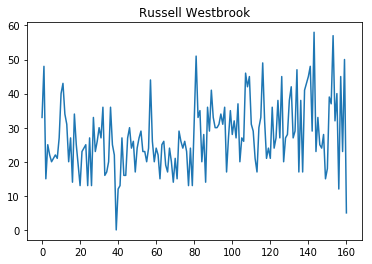

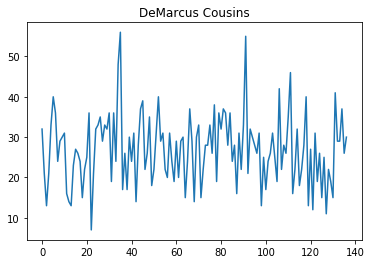

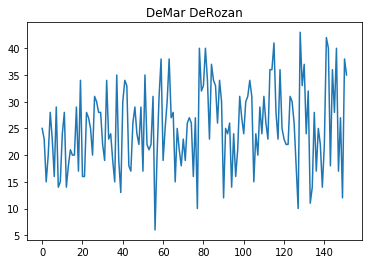

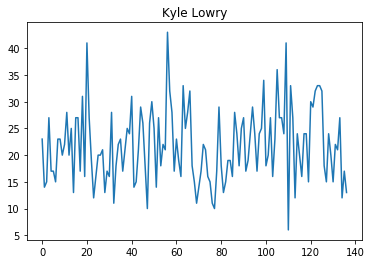

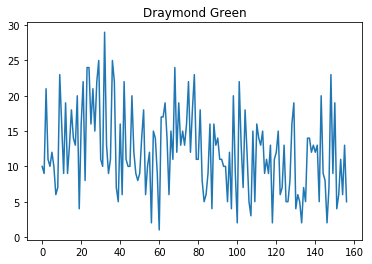

...

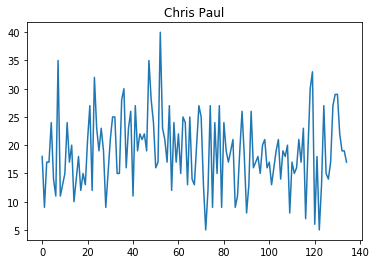

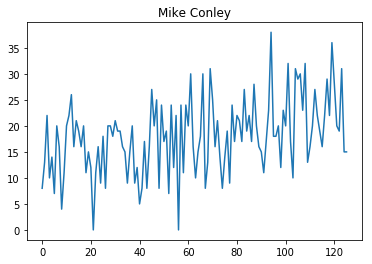

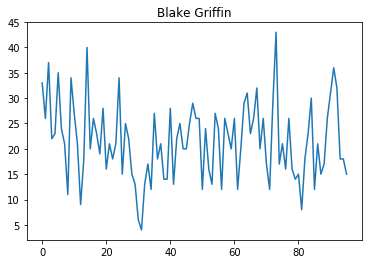

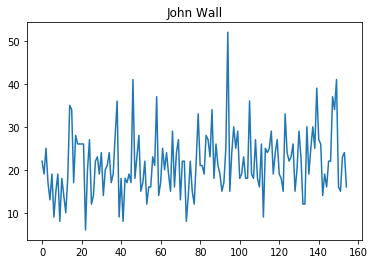

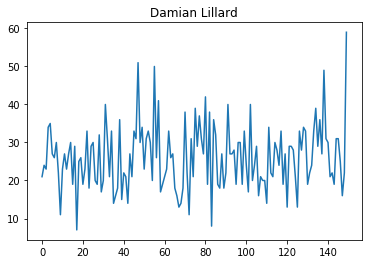

In [403]:
for player in players:
    pts = df_games.loc[(df_games.gmDate >= d1) & (df_games.gmDate <= d2) & (df_games.Player==player), 'PTS_G'].values
    plt.figure()
    plt.plot(pts)
    plt.title(player)
    plt.show()

In [394]:
def impactOfIndHist(player):
    cmp_metric = 'PTS_G'
    d1 = '2015-09-01'
    d2 = '2017-06-01'
    d1_ = '2014-09-01'
    d2_ = '2015-06-01'

    df_player = df_games[df_games.Player==player]
    df_player = df_player[(df_player.gmDate >= d1) & (df_player.gmDate <= d2)]

    print("*** {} ***".format(player))
    print()
    for metric in predMetrics:
        df_rslt = {'Good': list(), 'Bad': list()}
        Dates = df_player.gmDate.unique()
        for i in range(2, len(Dates)):         
            # all games prior to previous game
            prevDates = Dates[:i-1]
            temp = df_player.loc[df_player.gmDate.isin(prevDates), metric].ewm(0.94).mean()
            comparison_val = temp.values[-1]
            
            # previous game val
            prevDate = Dates[i-1]
            prev_val = df_player.loc[df_player.gmDate==prevDate, metric].mean()
            
            # current game val
            currDate = Dates[i]
            curr_val = df_player.loc[df_player.gmDate==currDate, metric].mean()
            
            # if ur previous game was 'bad' in reference to games played thus far
            if prev_val < comparison_val: 
                df_rslt['Bad'].append(curr_val)
            else:
                df_rslt['Good'].append(curr_val)
        #print("{} comp_val: {}".format(metric, comparison_val))
        print("Avg {} after good performance: {}".format(metric, np.nanmean(df_rslt['Good'])))
        print("Avg {} after bad performance: {}".format(metric, np.nanmean(df_rslt['Bad'])))
        print()

In [395]:
for player in players:
    impactOfIndHist(player)

*** Russell Westbrook ***

Avg PTS_G after good performance: 27.63157894736842
Avg PTS_G after bad performance: 27.16867469879518

Avg AST_G after good performance: 10.830985915492958
Avg AST_G after bad performance: 10.113636363636363

Avg TOV_G after good performance: 4.864197530864198
Avg TOV_G after bad performance: 4.782051282051282

Avg 3P_G after good performance: 1.7471264367816093
Avg 3P_G after bad performance: 2.013888888888889

Avg TRB_G after good performance: 9.548780487804878
Avg TRB_G after bad performance: 9.090909090909092

Avg STL_G after good performance: 1.835820895522388
Avg STL_G after bad performance: 1.8695652173913044

Avg BLK_G after good performance: 0.2702702702702703
Avg BLK_G after bad performance: 0.32786885245901637

Avg FG% after good performance: 0.41541948051948047
Avg FG% after bad performance: 0.4664987804878049

*** DeMarcus Cousins ***

Avg PTS_G after good performance: 26.84285714285714
Avg PTS_G after bad performance: 27.046153846153846

Avg AS

KeyboardInterrupt: 

In [386]:
# all games prior to previous game
metric = 'PTS_G'
prevDates = Dates[:i-1]
temp = df_player.loc[df_player.gmDate.isin(prevDates), metric].ewm(0.94).mean()
comparison_val = temp.values[-1]
            
# previous game val
prevDate = Dates[i-1]
prev_val = df_player.loc[df_player.gmDate==prevDate, metric].mean()
            
# current game val
currDate = Dates[i]
curr_val = df_player.loc[df_player.gmDate==currDate, metric].mean()

In [298]:
df_rslt = {'Win': list(), 'Loss': list()}
Dates = df_player.gmDate.unique()
for i in range(1, len(Dates)): 
    prevDate = Dates[i-1]
    rslt = df_player.loc[df_player.gmDate==prevDate, 'teamRslt']
    val = df_player.loc[df_player.gmDate==Dates[i], metric].mean()
    if (rslt == 'Win').bool(): 
        df_rslt['Win'].append(val)
    else:
        df_rslt['Loss'].append(val)
print("Avg {} after Win: {}".format(metric, np.mean(df_rslt['Win'])))
print("Avg {} after Loss: {}".format(metric, np.mean(df_rslt['Loss'])))

Avg FG% after Win: 0.4126521739130434
Avg FG% after Loss: 0.4109426470588235


In [50]:
# find validPlayers
d1 = '2016-09-01'
d2 = '2017-06-01'
df = stats_game[(stats_game.gmDate >= d1) & (stats_game.gmDate <= d2)].sort_values(by=['Player'])
names = df.Player.unique()
validPlayers = list(set(targetNames).intersection(set(names)))

# excluded names are those names that don't match (roughly 8 people)

In [19]:
players_dict = {}
for player in validPlayers: 
    player_dict = createPlayerDict(stats_game, player, pred_metrics, pred_year)
    players_dict.update({player: player_dict})

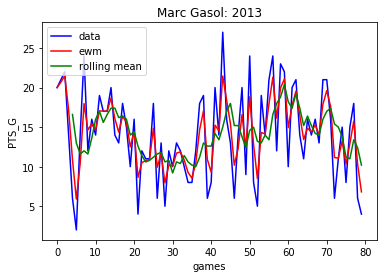

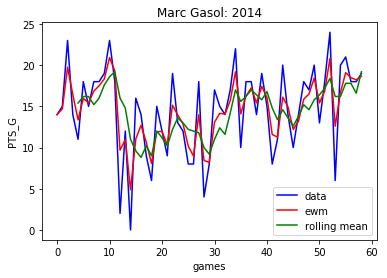

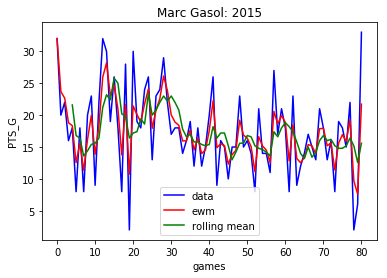

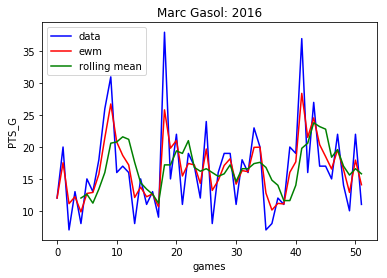

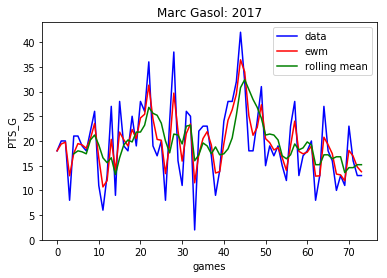

...

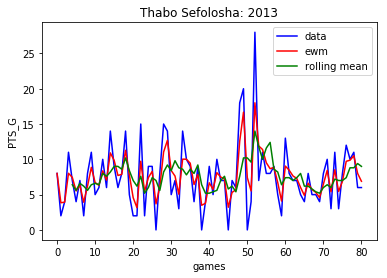

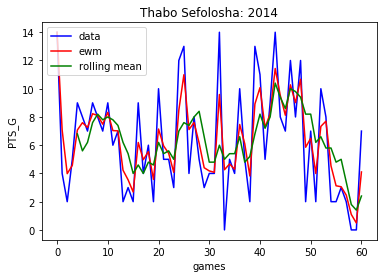

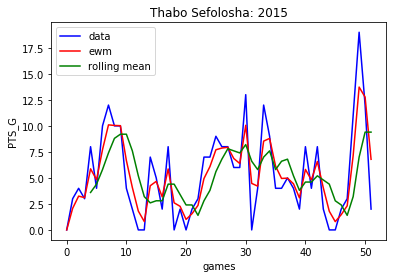

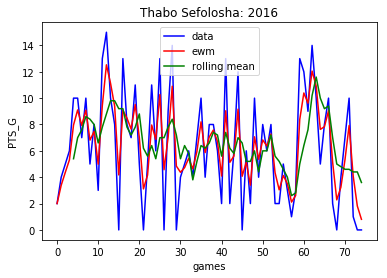

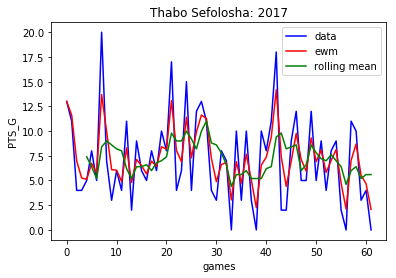

In [121]:
for player in validPlayers: 
    df = players_dict[player]['PTS_G'].T
    for year in df.columns:
        df_ = df[year].dropna()
        plt.figure()
        plt.plot(df_.values.flatten(), color='blue', label='data')
        plt.plot(df_.ewm(com=0.8).mean(), color='red', label='ewm')
        plt.plot(df_.rolling(5).mean(), color='green', label='rolling mean')
        plt.legend(loc='best')
        plt.ylabel(metric)
        plt.xlabel('games')
        plt.title(player + ': ' + year)
        plt.show()
    